### CRISP-DM Framework

<center>
    <img src = images/crisp.png width = 50%/>
</center>


# Step-1: Business Understanding

Recent Covid-19 Pandemic has raised alarms over one of the most overlooked area to focus: Healthcare Management. While healthcare management has various use cases for using data science, patient length of stay is one critical parameter to observe and predict if one wants to improve the efficiency of the healthcare management in a hospital.

This parameter helps hospitals to identify patients of high Length-Of-Stay (LOS) risk at the time of admission. Once identified, patients with high LOS risk can have their treatment plan optimized to miminize LOS and lower the chance of staff/visitor infection. Also, prior knowledge of LOS can aid in logistics such as room and bed allocation planning.

The task at hand is to build and train model(s) on existing patient information and be able to predict length-of-stay for new patients.

## Step-1.1: Translating Business Understanding to a Data Problem
The business requirement is to help hospital management understand what patient characteristics are influencing their length-of-stay at the hospital.

This high level business requirement can be translated into a data problem by asking questions like:
1. What factors (ie, 'independent-variables') are positively correlated with the 'Stay' (ie, 'target-variable'); what factors are negatively correlated?
2. Which independent-variable has highest influence on the target-variable?
3. Is there a correlation among the independent-variables?
4. How important are certain independent-variables over the others in making the Stay predictions?

# Step-2: Data understanding

Load the data and familiarize with it

1. See the available columns and their data-types
2. Some standard details like the min, max, std-dev of the numerical variables and possible values in the categorical variables
3. What percentage of data has null values. Start thinking about how to deal with them. Is there a logical way of filling the null values?
4. Are there unreasonable values in the numerical variables
5. Check the histograms and distributions to understand if scaling is needed

In [123]:
# Standard Imports
import pandas as pd
import numpy as np
import scipy as sp
import os

In [124]:
#Visualization related imports
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from matplotlib.ticker import ScalarFormatter
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import matplotlib.pyplot as plt
from sklearn.metrics import RocCurveDisplay

# Transformations related imports
from scipy.stats import boxcox

In [125]:
# Modeling related imports
from sklearn.preprocessing import PolynomialFeatures, OneHotEncoder, OrdinalEncoder
from sklearn.feature_selection import SequentialFeatureSelector, SelectFromModel
from sklearn.model_selection import train_test_split
from sklearn.compose import make_column_selector, make_column_transformer
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier, export_text, plot_tree
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.linear_model import Ridge, LinearRegression, Lasso
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import TransformedTargetRegressor, ColumnTransformer
from sklearn.model_selection import GridSearchCV
from sklearn.inspection import permutation_importance

from sklearn.preprocessing import LabelBinarizer

from sklearn.metrics import ConfusionMatrixDisplay, RocCurveDisplay
from sklearn.metrics import accuracy_score, recall_score, precision_score
from sklearn.metrics import f1_score

from sklearn import set_config
set_config(display="diagram")

In [126]:
# Ignore warnings
import warnings
warnings.filterwarnings('ignore')

In [127]:
## Some utility functions for data understanding

# Display the standard details like head(), info(), describe() on the given dataframe
def display_standard_details(df):
    display(df.head())
    display(df.info())
    display(df.describe())
    
# Utility aggregate function
def _get_null_pct(col):
    return "{:.2f}%".format(col.isna().sum()*100/col.shape[0])

# Utility function: Get unique column values
def _get_unique_vals(col):
    return col.unique()

# Display unique values in each column, number of unique values, percentage of null values
# This information can be used while cleaning/preparing the data
def display_meta_details(df):
    meta_df = df.agg(['nunique', _get_unique_vals, _get_null_pct]).T
    meta_df.columns = ['Num-Unique-Values', 'Unique-Values', '%-of-Nulls']
    display(meta_df)


In [128]:
def display_permutation_importance_features(est, X_trainset, y_trainset, X_testset, y_testset, n_rep=30):
    print('Permutation importance on train dataset')
    r = permutation_importance(est, X_trainset, y_trainset, n_repeats=n_rep)
    features = X_trainset.columns
    for i in r.importances_mean.argsort()[::-1]:
            print(f"{features[i]:<8}"
                  f" {r.importances_mean[i]:.3f}"
                  f" +/- {r.importances_std[i]:.3f}")

    print('\nPermutation importance on test dataset')
    r = permutation_importance(est, X_testset, y_testset, n_repeats=n_rep)
    features = X_testset.columns
    for i in r.importances_mean.argsort()[::-1]:
            print(f"{features[i]:<8}"
                  f" {r.importances_mean[i]:.3f}"
                  f" +/- {r.importances_std[i]:.3f}")

In [129]:
def warn(*args, **kwargs):
    pass

warnings.warn = warn

In [130]:
# Load data
hc_data = pd.read_csv('data/train_data.csv')

In [131]:
# Load data fields description
hc_data_descr = pd.read_csv('data/train_data_dictionary.csv')

In [132]:
# Description of the columns
display(hc_data_descr)

,Column,Description
0,case_id,Case_ID registered in Hospital
1,Hospital_code,Unique code for the Hospital
2,Hospital_type_code,Unique code for the type of Hospital
3,City_Code_Hospital,City Code of the Hospital
4,Hospital_region_code,Region Code of the Hospital
5,Available Extra Rooms in Hospital,Number of Extra rooms available in the Hospital
6,Department,Department overlooking the case
7,Ward_Type,Code for the Ward type
8,Ward_Facility_Code,Code for the Ward Facility
9,Bed Grade,Condition of Bed in the Ward


In [133]:
# Rename column names to
#  i). remove spaces
#  ii. query friendly
hc_data.columns=['Case_id', 'Hospital_code', 'Hospital_type_code', 'City_code_hospital', 'Hospital_region_code', 
            'Avail_extra_rooms', 'Department', 'Ward_type', 'Ward_facility_code', 
            'Bed_grade', 'Patient_id', 'City_code_patient', 'Admission_type', 'Severity_illness',
            'Visitors', 'Age', 'Admission_deposit', 'Stay']

In [134]:
# Display the standard detail of train data like head, info, describe
display_standard_details(hc_data)

,Case_id,Hospital_code,Hospital_type_code,City_code_hospital,Hospital_region_code,Avail_extra_rooms,Department,Ward_type,Ward_facility_code,Bed_grade,Patient_id,City_code_patient,Admission_type,Severity_illness,Visitors,Age,Admission_deposit,Stay
0,1,8,c,3,Z,3,radiotherapy,R,F,2.0,31397,7.0,Emergency,Extreme,2,51-60,4911.0,0-10
1,2,2,c,5,Z,2,radiotherapy,S,F,2.0,31397,7.0,Trauma,Extreme,2,51-60,5954.0,41-50
2,3,10,e,1,X,2,anesthesia,S,E,2.0,31397,7.0,Trauma,Extreme,2,51-60,4745.0,31-40
3,4,26,b,2,Y,2,radiotherapy,R,D,2.0,31397,7.0,Trauma,Extreme,2,51-60,7272.0,41-50
4,5,26,b,2,Y,2,radiotherapy,S,D,2.0,31397,7.0,Trauma,Extreme,2,51-60,5558.0,41-50


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 318438 entries, 0 to 318437
Data columns (total 18 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   Case_id               318438 non-null  int64  
 1   Hospital_code         318438 non-null  int64  
 2   Hospital_type_code    318438 non-null  object 
 3   City_code_hospital    318438 non-null  int64  
 4   Hospital_region_code  318438 non-null  object 
 5   Avail_extra_rooms     318438 non-null  int64  
 6   Department            318438 non-null  object 
 7   Ward_type             318438 non-null  object 
 8   Ward_facility_code    318438 non-null  object 
 9   Bed_grade             318325 non-null  float64
 10  Patient_id            318438 non-null  int64  
 11  City_code_patient     313906 non-null  float64
 12  Admission_type        318438 non-null  object 
 13  Severity_illness      318438 non-null  object 
 14  Visitors              318438 non-null  int64  
 15  

None

,Case_id,Hospital_code,City_code_hospital,Avail_extra_rooms,Bed_grade,Patient_id,City_code_patient,Visitors,Admission_deposit
count,318438.000000,318438.000000,318438.000000,318438.000000,318325.000000,318438.000000,313906.000000,318438.000000,318438.000000
mean,159219.500000,18.318841,4.771717,3.197627,2.625807,65747.579472,7.251859,3.284099,4880.749392
std,91925.276847,8.633755,3.102535,1.168171,0.873146,37979.936440,4.745266,1.764061,1086.776254
min,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,0.000000,1800.000000
25%,79610.250000,11.000000,2.000000,2.000000,2.000000,32847.000000,4.000000,2.000000,4186.000000
50%,159219.500000,19.000000,5.000000,3.000000,3.000000,65724.500000,8.000000,3.000000,4741.000000
75%,238828.750000,26.000000,7.000000,4.000000,3.000000,98470.000000,8.000000,4.000000,5409.000000
max,318438.000000,32.000000,13.000000,24.000000,4.000000,131624.000000,38.000000,32.000000,11008.000000


In [135]:
display_meta_details(hc_data)

,Num-Unique-Values,Unique-Values,%-of-Nulls
Case_id,318438,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",0.00%
Hospital_code,32,"[8, 2, 10, 26, 23, 32, 1, 22, 16, 9, 6, 29, 12...",0.00%
Hospital_type_code,7,"[c, e, b, a, f, d, g]",0.00%
City_code_hospital,11,"[3, 5, 1, 2, 6, 9, 10, 4, 11, 7, 13]",0.00%
Hospital_region_code,3,"[Z, X, Y]",0.00%
Avail_extra_rooms,18,"[3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 12, 0, 11, 20,...",0.00%
Department,5,"[radiotherapy, anesthesia, gynecology, TB & Ch...",0.00%
Ward_type,6,"[R, S, Q, P, T, U]",0.00%
Ward_facility_code,6,"[F, E, D, B, A, C]",0.00%
Bed_grade,4,"[2.0, 3.0, 4.0, 1.0, nan]",0.04%


#### The Patient_id count and the Case_id counts are not equal. This points to the fact that there are more than one Case_ids per Patient. Let's look at some of the details related to this.

In [136]:
patient_uniq = hc_data.groupby('Patient_id')

patient_uniq_stay = patient_uniq['Stay'].describe()

patient_uniq_stay.columns = ['Num-Case-ids', 'Num-Unique-Stays', 'Top-Stay', 'Freq-of-Top-Stay']
patient_uniq_stay.head()

,Num-Case-ids,Num-Unique-Stays,Top-Stay,Freq-of-Top-Stay
Patient_id,,,,
1,4,2,11-20,3
2,2,2,31-40,1
4,2,1,21-30,2
6,1,1,11-20,1
7,4,3,11-20,2


In [137]:
patient_uniq_stay.sort_values(by='Num-Case-ids', ascending=False).head()

,Num-Case-ids,Num-Unique-Stays,Top-Stay,Freq-of-Top-Stay
Patient_id,,,,
66714,50,10,More than 100 Days,14
91292,43,7,More than 100 Days,28
38525,39,8,51-60,10
101359,36,7,More than 100 Days,28
33491,34,8,71-80,11


In [138]:
#  Patient_id 66714 has the highest number of admissions (i.e, Case_ids). Look at few of those instances
hc_data.loc[hc_data['Patient_id']==66714].head()

,Case_id,Hospital_code,Hospital_type_code,City_code_hospital,Hospital_region_code,Avail_extra_rooms,Department,Ward_type,Ward_facility_code,Bed_grade,Patient_id,City_code_patient,Admission_type,Severity_illness,Visitors,Age,Admission_deposit,Stay
253799,253800,6,a,6,X,4,gynecology,R,F,3.0,66714,2.0,Trauma,Extreme,18,71-80,2988.0,More than 100 Days
253800,253801,6,a,6,X,3,gynecology,R,F,3.0,66714,2.0,Trauma,Extreme,18,71-80,4601.0,More than 100 Days
253801,253802,26,b,2,Y,2,radiotherapy,S,D,1.0,66714,2.0,Trauma,Extreme,2,71-80,5548.0,More than 100 Days
253802,253803,26,b,2,Y,2,radiotherapy,S,D,1.0,66714,2.0,Trauma,Extreme,2,71-80,5617.0,More than 100 Days
253803,253804,6,a,6,X,4,radiotherapy,Q,F,2.0,66714,2.0,Trauma,Extreme,2,71-80,3269.0,51-60


### Tips for Data Preparation
1. Replace 'More than 100 Days' to '100+' in the target variable (Stay). Helps while visualizing


2. There's a small percentage of null-values (0.04% and 1.42%) in 2 columns. Drop the rows with null values.


3. Drop 'Case_id' and 'Patient_id' columns. These don't contribute to modeling

#### Preliminary Data Preparation

In [139]:
# Implement Tip 1
hc_data['Stay'].replace({'More than 100 Days': '100+'}, inplace=True)

# Implement Tip 2
hc_data.dropna(inplace=True)

#Other Tips are implemented in next stage


### Exploratory Data Analysis

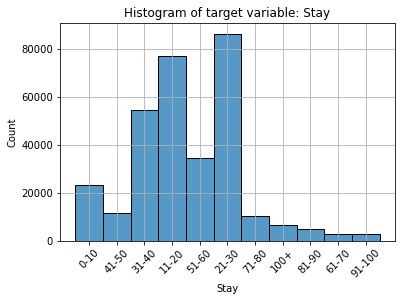

In [231]:
# View the distribution of target variable: Stay
sns.histplot(data=hc_data['Stay']).set(title='Histogram of target variable: Stay')
plt.xticks(rotation=45)
plt.grid()
plt.show()

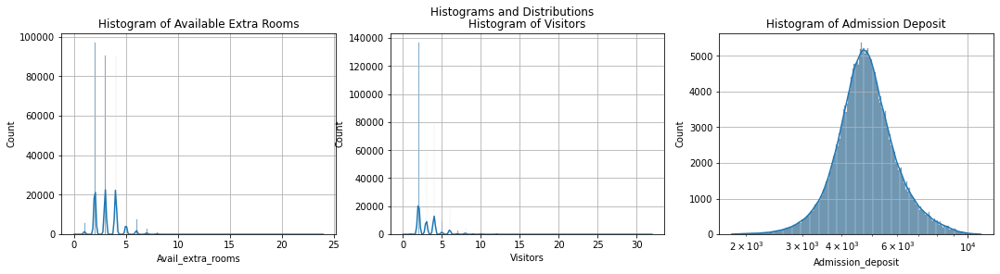

In [140]:
# View the distributions of the numerical variables
fig, axes = plt.subplots(ncols=3, figsize=(18, 4))

fig.suptitle("Histograms and Distributions")
sns.histplot(ax=axes[0], x=hc_data['Avail_extra_rooms'], kde=True)
axes[0].set_title('Histogram of Available Extra Rooms')
axes[0].grid()

sns.histplot(ax=axes[1], x=hc_data['Visitors'], kde=True)
axes[1].set_title('Histogram of Visitors')
axes[1].grid()

sns.histplot(ax=axes[2], x=hc_data['Admission_deposit'], log_scale=True, kde=True)
axes[2].set_title('Histogram of Admission Deposit')
axes[2].grid()
fig.savefig('images/histograms_raw_data.png')

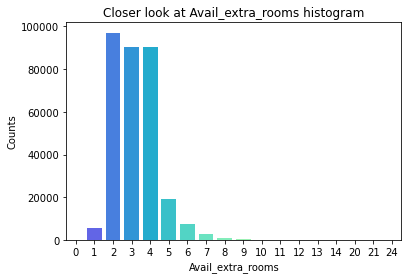

In [141]:
# See the distributions of Avail_extra_rooms and Visitors.
# The idea is to visualize and chop off the tails in the above histograms

c=sns.countplot(data=hc_data, x='Avail_extra_rooms', palette='rainbow')
c.set_xlabel('Avail_extra_rooms');
c.set_ylabel('Counts');
c.set_title('Closer look at Avail_extra_rooms histogram');

In [142]:
avail_rm_thresh = 10
avail_rm_thresh_pct = (hc_data.query('Avail_extra_rooms > @avail_rm_thresh')['Avail_extra_rooms'].value_counts().sum()*100)/len(hc_data)
print("Percentage of records with Avail_extra_rooms > {} is {:.2f}%".format(avail_rm_thresh, avail_rm_thresh_pct))

Percentage of records with Avail_extra_rooms > 10 is 0.01%


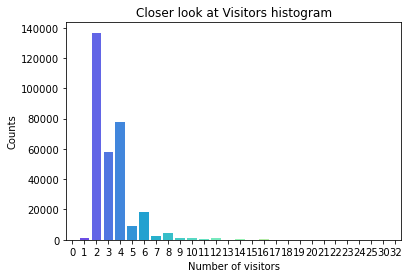

In [143]:
c=sns.countplot(data=hc_data, x='Visitors', palette='rainbow')
c.set_xlabel('Number of visitors');
c.set_ylabel('Counts');
c.set_title('Closer look at Visitors histogram');

In [144]:
visitor_thresh = 14
visitor_thresh_pct = (hc_data.query('Visitors > @visitor_thresh')['Visitors'].value_counts().sum()*100)/len(hc_data)
print("Percentage of records with Visitors > {} is {:.2f}%".format(visitor_thresh, visitor_thresh_pct))

Percentage of records with Visitors > 14 is 0.24%


#### Look at the violin plots of these columns to reinforce the above understanding

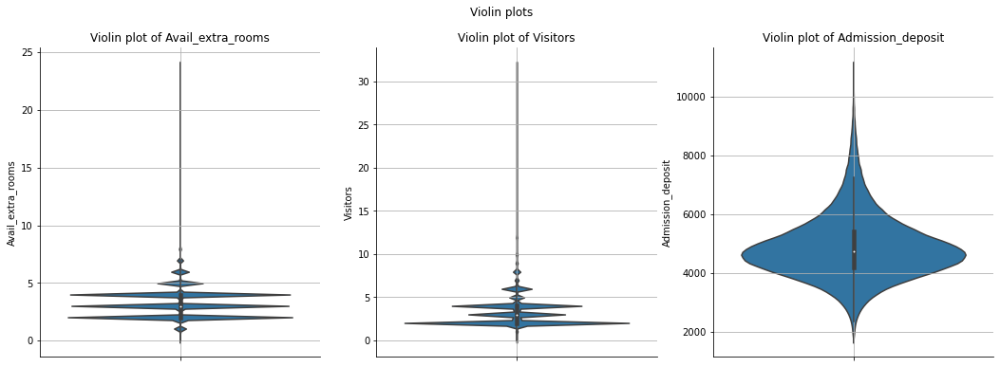

In [145]:
fig, axes = plt.subplots(ncols=3, figsize=(18, 6))
sns.despine(fig)
fig.suptitle("Violin plots");

sns.violinplot(ax=axes[0], data=hc_data, y='Avail_extra_rooms')
axes[0].set_title('Violin plot of Avail_extra_rooms');
axes[0].grid()

sns.violinplot(ax=axes[1], data=hc_data, y='Visitors')
axes[1].set_title('Violin plot of Visitors');
axes[1].grid()

sns.violinplot(ax=axes[2], data=hc_data, y='Admission_deposit')
axes[2].set_title('Violin plot of Admission_deposit');
axes[2].grid()

##### Tip for Data-cleaning: Drop the records with Avail_extra_rooms > 9 and Visitors > 10. This will give a more normal distribution-like shape to those variables. These records are more of like outliers.

#### Some more plots to understand data better. See 'Summary of Data understanding' cell below for conclusions from above plots

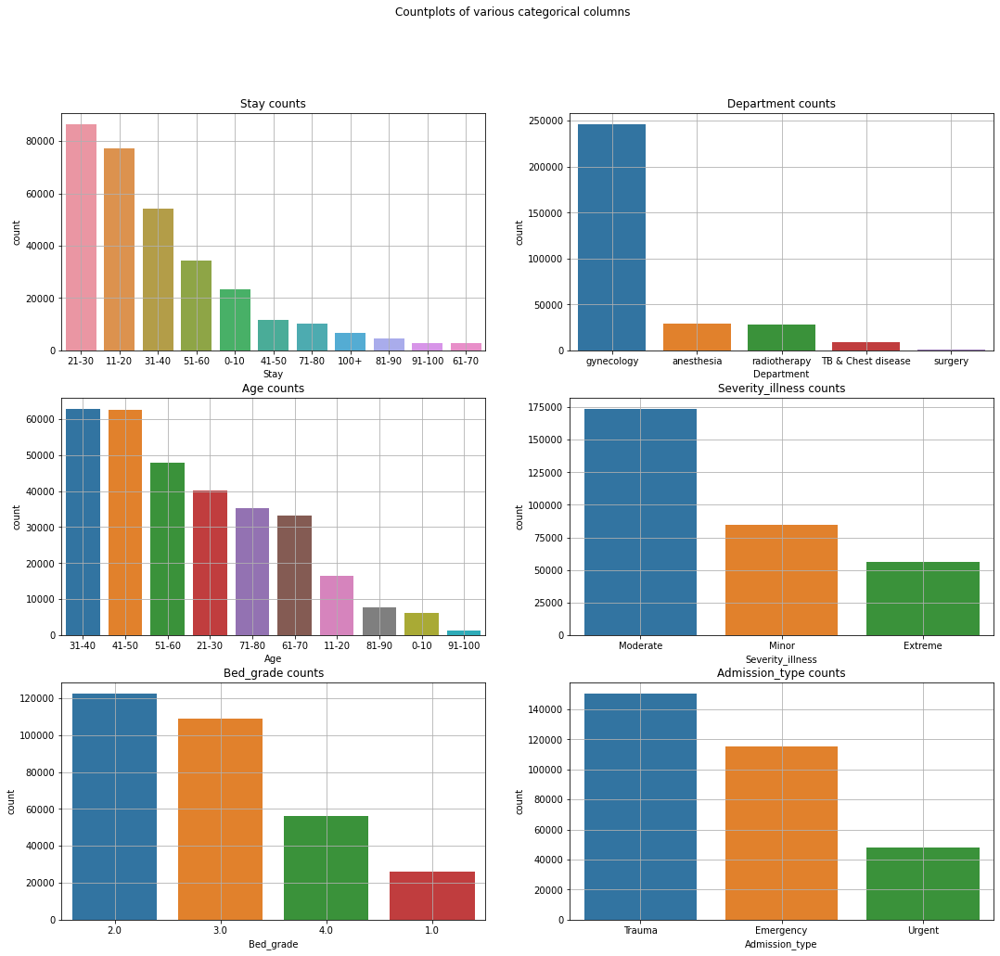

In [146]:
fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(18, 16))

fig.suptitle("Countplots of various categorical columns")


sns.countplot(ax=axes[0][0], data=hc_data, x='Stay',
              order = hc_data['Stay'].value_counts().index);
axes[0][0].set_title('Stay counts')
axes[0][0].grid()

sns.countplot(ax=axes[0][1], data=hc_data, x='Department',
              order = hc_data['Department'].value_counts().index);
axes[0][1].set_title('Department counts')
axes[0][1].grid()

sns.countplot(ax=axes[1][0], data=hc_data, x='Age',
              order = hc_data['Age'].value_counts().index);
axes[1][0].set_title('Age counts')
axes[1][0].grid()

sns.countplot(ax=axes[1][1], data=hc_data, x='Severity_illness',
              order = hc_data['Severity_illness'].value_counts().index);
axes[1][1].set_title('Severity_illness counts')
axes[1][1].grid()

sns.countplot(ax=axes[2][0], data=hc_data, x='Bed_grade',
              order = hc_data['Bed_grade'].value_counts().index);
axes[2][0].set_title('Bed_grade counts')
axes[2][0].grid()

sns.countplot(ax=axes[2][1], data=hc_data, x='Admission_type',
              order = hc_data['Admission_type'].value_counts().index);
axes[2][1].set_title('Admission_type counts')
axes[2][1].grid()


In [147]:
fig1 = px.histogram(data_frame=hc_data, x='Stay', color='Severity_illness', 
             category_orders={'Stay': ["0-10", "11-20", "21-30", "31-40", "41-50", "51-60",
                                      "61-70", "71-80", "81-90", "91-100", "100+"]},
            color_discrete_sequence=px.colors.qualitative.Pastel, width=900, height=400)

fig1.update_layout(
            title=dict(text="Counts of 'Severity_illness' against the target variable 'Stay'",
            font=dict(size=14)), )
fig1.show()

fig2 = px.histogram(data_frame=hc_data, x='Stay', color='Admission_type', 
             category_orders={'Stay': ["0-10", "11-20", "21-30", "31-40", "41-50", "51-60",
                                      "61-70", "71-80", "81-90", "91-100", "100+"]},
            color_discrete_sequence=px.colors.qualitative.Pastel, width=900, height=400)

fig2.update_layout(
            title=dict(text="Counts of 'Admission_type' against the target variable 'Stay'",
            font=dict(size=14)))
fig2.show()

fig3 = px.histogram(data_frame=hc_data, x='Stay', color='Bed_grade', 
             category_orders={'Stay': ["0-10", "11-20", "21-30", "31-40", "41-50", "51-60",
                                      "61-70", "71-80", "81-90", "91-100", "100+"],
                              'Bed_grade': ["1.0", "2.0", "3.0", "4.0"]},
            color_discrete_sequence=px.colors.qualitative.Pastel, width=900, height=400)

fig3.update_layout(
            title=dict(text="Counts of 'Bed_grade' against the target variable 'Stay'",
            font=dict(size=14)))
fig3.show()

fig4 = px.histogram(data_frame=hc_data, x='Stay', color='Department', 
             category_orders={'Stay': ["0-10", "11-20", "21-30", "31-40", "41-50", "51-60",
                                      "61-70", "71-80", "81-90", "91-100", "100+"],
                              'Bed_grade': ["1.0", "2.0", "3.0", "4.0"]},
            color_discrete_sequence=px.colors.qualitative.Pastel, width=900, height=400)

fig4.update_layout(
            title=dict(text="Counts of 'Department' against the target variable 'Stay'",
            font=dict(size=14)))
fig4.show()

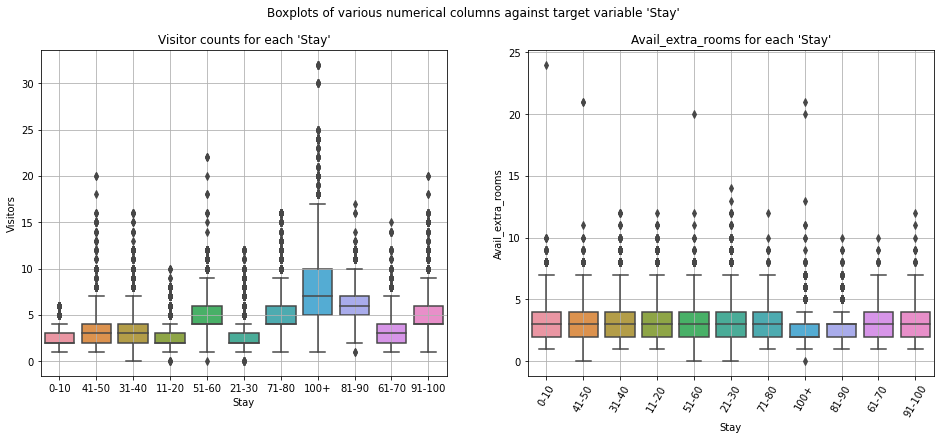

In [148]:
fig, axes = plt.subplots(ncols=2, figsize=(16, 6))

fig.suptitle("Boxplots of various numerical columns against target variable 'Stay'")

sns.boxplot(ax=axes[0], data=hc_data, x='Stay', y='Visitors')
plt.xticks(rotation=60);
axes[0].set_title("Visitor counts for each 'Stay'")
axes[0].grid()

sns.boxplot(ax=axes[1], data=hc_data, x='Stay', y='Avail_extra_rooms')
plt.xticks(rotation=60);
axes[1].set_title("Avail_extra_rooms for each 'Stay'")
axes[1].grid()


#### The means of 'Visitors' for most 'Stay' classes seem to be inline with the overall mean of 'Visitors' column (which is 3.28)
#### Similarly, the means of 'Avail_extra_rooms' for most 'Stay' classes seem to be inline with the overall mean of 'Avail_extra_rooms' column (which is 3.28)

#### No further data-cleaning needed w.r.t. these columns

## Summary of Data understanding

1. The Admission_deposit has a very nice normal distribution curve. No fine tuning needed for this column


2. A given patientid has multiple entries. This could be because the patient got admitted more than once. However, the case_ids of a patient are consecutive; this looks a bit weird and hinting that only for one admission, multiple entries got added (due to clerical error or different departments, etc). I have a suspicion this might skew results. But let's see after building some models.


3. Very high percentage of patients were admitted into Gynaecology department. 


4. Another observation is that "anesthesia" is a department by itself. A patient wouldn't get admitted just for getting anesthesia. I strongly believe these patients were actually admitted in regular departments who happened to need anesthesia for the treatment. Need to see if this 'superficial' department will impact the predictions. Let's keep this in mind for any fine-tuning the results


5. Bulk of the Stays are between 11 days to 40days. 
     a. Of these Stays, there are more 'Moderate' Severity-of-illness cases than 'Extreme' Severity
     b. Of these Stays, the patients with Bed_grades 3 and 4 are more than Bed_grades 1 and 2
     c. Of these Stays, most patients are from Gynaecology Department. This is not new information as the total patients admitted are in that department anyway



### More Tips for Data Preparation

4. Drop the records with Avail_extra_rooms > 9 and Visitors > 10. This will give a more normal distribution like shape to those variables. These records are more of like outliers.


# Step-3: Data Preparation

In [149]:

# Implement Tip 3 from previous stage
hc_data_clean = hc_data.drop(columns=['Case_id', 'Patient_id'], axis=1)

# Implement Tip-4 from previous stage
avail_rm_thresh = 9
visitor_thresh = 10
hc_data_clean2 = hc_data_clean.query('Avail_extra_rooms <= @avail_rm_thresh and Visitors <= @visitor_thresh')

print("Deleted {:.2f}% records".format((len(hc_data_clean) - len(hc_data_clean2))*100/len(hc_data_clean)))


Deleted 0.78% records


#### Ensure that the tails are chopped by looking at the Violin plots again (on hc_data_clean2)

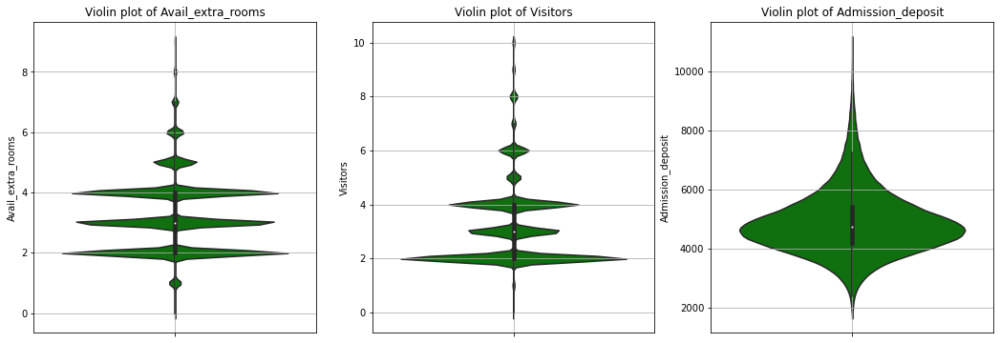

In [150]:
hc_data_clean2fig, axes = plt.subplots(ncols=3, figsize=(18, 6))
sns.despine(fig)
fig.suptitle("Violin plots after chopping the long tails");

sns.violinplot(ax=axes[0], data=hc_data_clean2, y='Avail_extra_rooms', color='g')
axes[0].set_title('Violin plot of Avail_extra_rooms');
axes[0].grid()

sns.violinplot(ax=axes[1], data=hc_data_clean2, y='Visitors', color='g')
axes[1].set_title('Violin plot of Visitors');
axes[1].grid()

sns.violinplot(ax=axes[2], data=hc_data_clean2, y='Admission_deposit', color='g')
axes[2].set_title('Violin plot of Admission_deposit');
axes[2].grid()

In [151]:
hc_data_clean2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 311360 entries, 0 to 318437
Data columns (total 16 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   Hospital_code         311360 non-null  int64  
 1   Hospital_type_code    311360 non-null  object 
 2   City_code_hospital    311360 non-null  int64  
 3   Hospital_region_code  311360 non-null  object 
 4   Avail_extra_rooms     311360 non-null  int64  
 5   Department            311360 non-null  object 
 6   Ward_type             311360 non-null  object 
 7   Ward_facility_code    311360 non-null  object 
 8   Bed_grade             311360 non-null  float64
 9   City_code_patient     311360 non-null  float64
 10  Admission_type        311360 non-null  object 
 11  Severity_illness      311360 non-null  object 
 12  Visitors              311360 non-null  int64  
 13  Age                   311360 non-null  object 
 14  Admission_deposit     311360 non-null  float64
 15  

### More Data Preparation Tips

1. Use OrdinalEncoder for columns: Severity_illness, Age.  The categories in these columns have an order


2. Use OneHotEncoder for columns: Hospital_code, Hospital_type_code, City_code_hospital, Hospital_region_code, Department, Ward_type, Ward_facility_code, Bed_grade, City_code_patient, Admission_type


#### These will be implemented in Pipelines during model building

In [152]:
target_map = {'0-10':0, '11-20':1, '21-30':2, '31-40':3, '41-50':4, '51-60':5, '61-70':6, 
              '71-80':7, '81-90':8, '91-100':9, '100+':10}

In [153]:
target_rev_map = {0:'0-10', 1:'11-20', 2:'21-30', 3:'31-40', 4:'41-50', 5:'51-60', 6:'61-70', 
                  7:'71-80', 8:'81-90', 9:'91-100', 10:'100+'}

#### Split the data into training, validation and test datasets

In [154]:
# Define the predictor variables (X) and target variable y
# Perform a train/development/test split of 70/20/10
# Using stratification, so that the target variable classes are distributed equally in train/dev/test sets

X = hc_data_clean2.drop(columns=['Stay'])
y = hc_data_clean2['Stay'].map(target_map)

print("Dataset size:\t{}, {}".format(X.shape, y.shape))
train_size = int(X.shape[0] * 0.70)
dev_size   = int(X.shape[0] * 0.20)
test_size  = int(X.shape[0] * 0.10)

# First get the test split
X_train_tmp, X_test, y_train_tmp, y_test = train_test_split(X, y, test_size=test_size, random_state=1234, stratify=y)
# Then get the train and dev splits
X_train, X_dev, y_train, y_dev = train_test_split(X_train_tmp, y_train_tmp, train_size=train_size, random_state=1234,
                                                  stratify=y_train_tmp)

print("Trainset size:\t{}, {}".format(X_train.shape, y_train.shape))
print("Devset size:\t{}, {}".format(X_dev.shape, y_dev.shape))
print("Testset size:\t{}, {}".format(X_test.shape, y_test.shape))

Dataset size:	(311360, 15), (311360,)
Trainset size:	(217952, 15), (217952,)
Devset size:	(62272, 15), (62272,)
Testset size:	(31136, 15), (31136,)


In [155]:
# Utility functions
def print_train_test_evaluation(est, X_trainset, y_trainset, X_devset, y_devset, X_testset, y_testset, descr):
    curmodel_acc_train = round(accuracy_score(y_trainset, est.predict(X_trainset))*100, 2)
    curmodel_acc_dev   = round(accuracy_score(y_devset, est.predict(X_devset))*100, 2)
    curmodel_acc_test  = round(accuracy_score(y_testset, est.predict(X_testset))*100, 2)
    curmodel_f1_test   = round(f1_score(y_testset, est.predict(X_testset), average='micro')*100, 2)

    print(f'{descr} accuracy on train-data:\t{curmodel_acc_train}')
    print(f'{descr} accuracy on dev-data: \t{curmodel_acc_dev}')
    print(f'{descr} accuracy on test-data:\t{curmodel_acc_test}')
    print(f'{descr} F1 score on test-data:\t{curmodel_f1_test}')
    
    return curmodel_acc_train,curmodel_acc_dev,curmodel_acc_test,curmodel_f1_test

# Step-4: Modeling

I will build models using:
+ Logistic Regression
+ kNN
+ Decision Trees
+ Random Forests
+ Boosting techniques


In [156]:
# I'll maintain results of the models in the below list of lists
# Each entry will be a list with format: 
#   ['Model-name', 'Model-description', 'Purpose', '# Dimensions', 'Train/Dev/Test Accuracy scores', 'F1 Score']
results = []

##### Model 0: This is just for a base-line and not a real ML model. If someone was guessing the target variable at random, what would be the accuracy?

There are 11 classes in the target variable 'Stay'. So, a random guessing will result in 100/11 = 9.09% accuracy

In [157]:
results.append(['Model0', 'Random guessing', 'For a baseline', '---', '9.09', '---'])

#### Build Logistic Regression based model(s)

##### Model 1: Logistic regression model with default options.

In [158]:
onehot_cols = ['Hospital_code', 'Hospital_type_code', 'City_code_hospital', 'Hospital_region_code', 'Department',
              'Ward_type', 'Ward_facility_code', 'Bed_grade', 'City_code_patient', 'Admission_type']

ordinal_cols = ['Severity_illness', 'Age']

In [159]:
ordinal_ohe_transformer = make_column_transformer(
                            (OneHotEncoder(drop = 'if_binary'), onehot_cols),
                            (OrdinalEncoder(categories = [['0-10', '11-20', '21-30', '31-40', '41-50', '51-60',
                                                           '61-70', '71-80', '81-90', '91-100']]), ['Age']),
                            (OrdinalEncoder(categories = [['Minor', 'Moderate', 'Extreme']]), ['Severity_illness']),
                            remainder=StandardScaler())

In [160]:
model1 = Pipeline([('transformer', ordinal_ohe_transformer),
                     ('lgr', LogisticRegression(multi_class='ovr', random_state=1234, max_iter=1000))])
model1.fit(X_train, y_train)

display(model1)

Pipeline(steps=[('transformer',
                 ColumnTransformer(remainder=StandardScaler(),
                                   transformers=[('onehotencoder',
                                                  OneHotEncoder(drop='if_binary'),
                                                  ['Hospital_code',
                                                   'Hospital_type_code',
                                                   'City_code_hospital',
                                                   'Hospital_region_code',
                                                   'Department', 'Ward_type',
                                                   'Ward_facility_code',
                                                   'Bed_grade',
                                                   'City_code_patient',
                                                   'Admission_type']),
                                                 ('ordinalencoder-1',
                                                  OrdinalEncoder(categories=[['0-10',
                                                                              '11-20',
                                                                              '21-30',
                                                                              '31-40',
                                                                              '41-50',
                                                                              '51-60',
                                                                              '61-70',
                                                                              '71-80',
                                                                              '81-90',
                                                                              '91-100']]),
                                                  ['Age']),
                                                 ('ordinalencoder-2',
                                                  OrdinalEncoder(categories=[['Minor',
                                                                              'Moderate',
                                                                              'Extreme']]),
                                                  ['Severity_illness'])])),
                ('lgr',
                 LogisticRegression(max_iter=1000, multi_class='ovr',
                                    random_state=1234))])

In [161]:
model1_acc_train,model1_acc_dev,model1_acc_test,model1_f1_test = \
        print_train_test_evaluation(model1, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model1 Logistic Regression")

Model1 Logistic Regression accuracy on train-data:	38.91
Model1 Logistic Regression accuracy on dev-data: 	38.85
Model1 Logistic Regression accuracy on test-data:	38.65
Model1 Logistic Regression F1 score on test-data:	38.65


#### Model1 performance is around 38%; Much better than a random guessing scheme, but not good enough for being a good predictor. Even the accuracy on train dataset is just about the same.

#### Let's look at the confusion matrix to see it gives any clues

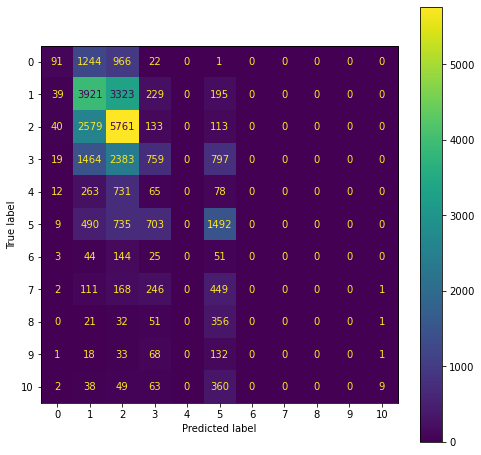

In [162]:
fig, axes = plt.subplots( figsize=(8, 8))
ConfusionMatrixDisplay.from_predictions(y_test, model1.predict(X_test), ax=axes);

##### <ins>Conclusion on Model 1:</ins>
1. The train/dev/test accuracies are on the lower side with Model 1. 


2. The fact that the train accuracy is also low, indicates the model is under-fitting.


3. A large chunk of Label 1 is predicted as Label 2. Similarly, a large chunk of Label 2 is predicted as Label 1. If the model can be improved to differentiate these labels, the accuracies will improve dramatically. On those lines, these are the low-hanging fruits. 


4. It is hard to find the dimensionality if OrdinalEncoder is present in make_column_transformer. In the next, model, I will encode all the categorical variables as one-hot. If the performance improves or atleast at par with model-1, I'll ignore OrdinalEncoder going forward

In [163]:
results.append(['Model1', 'Logistic Regr', 'Initial logistic regr model', '---',
                '{}/{}/{}'.format(model1_acc_train, model1_acc_dev, model1_acc_test),
                model1_f1_test])

##### Let's take a closer exploratory data analysis for target Label 1 and 2 (i.e., Stay of 11-20 and 21-30 days), since there seems to be a big overlap in the confusion matrix for these two target labels

In [164]:
hc_data_label1and2 = hc_data.query('Stay in "11-20" or Stay in "21-30"')

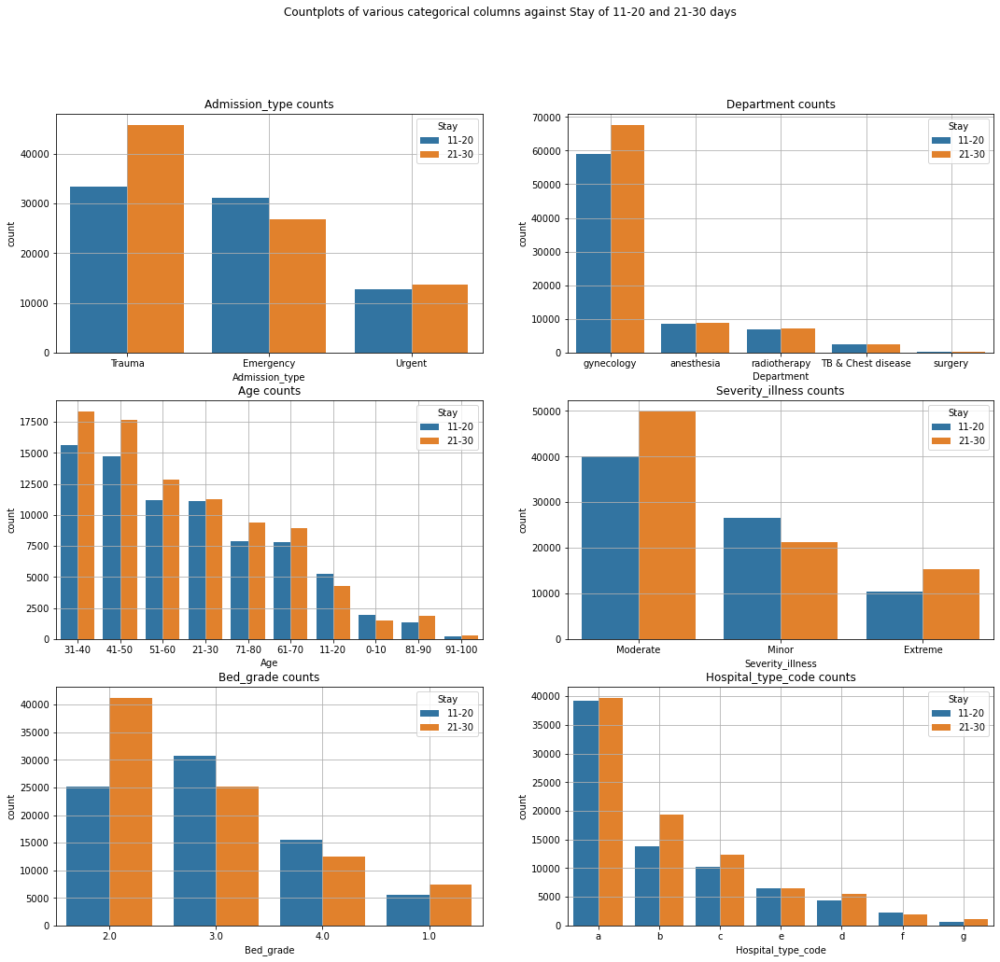

In [232]:
fig2, axes = plt.subplots(nrows=3, ncols=2, figsize=(18, 16))
fig2.suptitle("Countplots of various categorical columns against Stay of 11-20 and 21-30 days")

sns.countplot(ax=axes[0][0], data=hc_data_label1and2, x='Admission_type',
              order = hc_data_label1and2['Admission_type'].value_counts().index, hue='Stay');
axes[0][0].set_title('Admission_type counts')
axes[0][0].grid()

sns.countplot(ax=axes[0][1], data=hc_data_label1and2, x='Department',
              order = hc_data_label1and2['Department'].value_counts().index, hue='Stay');
axes[0][1].set_title('Department counts')
axes[0][1].grid()

sns.countplot(ax=axes[1][0], data=hc_data_label1and2, x='Age',
              order = hc_data_label1and2['Age'].value_counts().index, hue='Stay');
axes[1][0].set_title('Age counts')
axes[1][0].grid()

sns.countplot(ax=axes[1][1], data=hc_data_label1and2, x='Severity_illness',
              order = hc_data_label1and2['Severity_illness'].value_counts().index, hue='Stay');
axes[1][1].set_title('Severity_illness counts')
axes[1][1].grid()

sns.countplot(ax=axes[2][0], data=hc_data_label1and2, x='Bed_grade',
              order = hc_data_label1and2['Bed_grade'].value_counts().index, hue='Stay');
axes[2][0].set_title('Bed_grade counts')
axes[2][0].grid()

sns.countplot(ax=axes[2][1], data=hc_data_label1and2, x='Hospital_type_code',
              order = hc_data_label1and2['Hospital_type_code'].value_counts().index, hue='Stay');
axes[2][1].set_title('Hospital_type_code counts')
axes[2][1].grid()

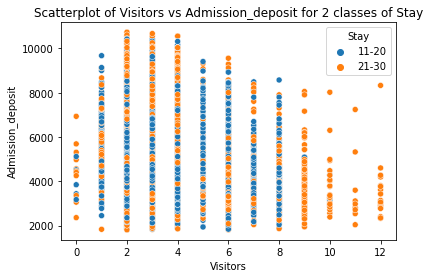

In [166]:
sns.scatterplot(data=hc_data_label1and2, x='Visitors', y='Admission_deposit', hue='Stay').set(title='Scatterplot of Visitors vs Admission_deposit for 2 classes of Stay');


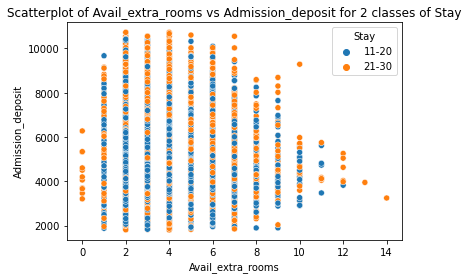

In [167]:
sns.scatterplot(data=hc_data_label1and2, x='Avail_extra_rooms', y='Admission_deposit', hue='Stay').set(title='Scatterplot of Avail_extra_rooms vs Admission_deposit for 2 classes of Stay');

#### Conclusion on Closer look at Stays 11-20 and 21-30

Looking at the scatterplots, when the number of Visitors is <= 8, it seems like there's lot of overlap between these two target classes. Similarly, until Avail_extra_rooms is <= 12, there's seems to be a lot of overlap between these two target classes

##### Model 2: Model 1 + Onehot encoding for all categorical variables. This is to see if it makes any performance difference by eliminating Ordinal encoding

In [168]:
cat_cols = ['Hospital_code', 'Hospital_type_code', 'City_code_hospital', 'Hospital_region_code', 'Department',
              'Ward_type', 'Ward_facility_code', 'Bed_grade', 'City_code_patient', 'Admission_type',
               'Severity_illness', 'Age']


In [169]:
ohe_transformer = make_column_transformer(
                            (OneHotEncoder(drop = 'if_binary'), cat_cols),
                            remainder=StandardScaler())

In [170]:
model2 = Pipeline([('transformer', ohe_transformer),
                     ('lgr', LogisticRegression(multi_class='ovr', random_state=1234, max_iter=1000))])
model2.fit(X_train, y_train)

display(model2)

Pipeline(steps=[('transformer',
                 ColumnTransformer(remainder=StandardScaler(),
                                   transformers=[('onehotencoder',
                                                  OneHotEncoder(drop='if_binary'),
                                                  ['Hospital_code',
                                                   'Hospital_type_code',
                                                   'City_code_hospital',
                                                   'Hospital_region_code',
                                                   'Department', 'Ward_type',
                                                   'Ward_facility_code',
                                                   'Bed_grade',
                                                   'City_code_patient',
                                                   'Admission_type',
                                                   'Severity_illness',
                                                   'Age'])])),
                ('lgr',
                 LogisticRegression(max_iter=1000, multi_class='ovr',
                                    random_state=1234))])

In [171]:
model2_acc_train,model2_acc_dev,model2_acc_test,model2_f1_test = \
        print_train_test_evaluation(model2, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model2 Logistic Regression")

Model2 Logistic Regression accuracy on train-data:	38.97
Model2 Logistic Regression accuracy on dev-data: 	38.89
Model2 Logistic Regression accuracy on test-data:	38.87
Model2 Logistic Regression F1 score on test-data:	38.87


In [172]:
model2_dims = len(model2.named_steps['transformer'].get_feature_names_out().tolist())
print(f'Logistic Regression Model2 Number of dimensions:\t{model2_dims}')

Logistic Regression Model2 Number of dimensions:	130


In [173]:
results.append(['Model2', 'Basic Logistic Regr with OneHot on all categ', 'Baseline', '{}'.format(model2_dims),
                '{}/{}/{}'.format(model2_acc_train, model2_acc_dev, model2_acc_test),
                model2_f1_test])

##### <ins>Conclusion on Model 2:</ins>
1. Pretty much same as Model 1 


2. As the OrdinalEncoding is not making much difference, I'll continue to use OneHot encoding on all categorical variables from now on, to simplify

##### Model 3: Try different hyper-parameters of Logistic Regression using GridSearchCV

In [174]:
model3_param_dict = {'lgr__C': np.logspace(-5, .5, 10),
                     'lgr__multi_class': ['ovr', 'multinomial'],
                     'lgr__max_iter': [1000, 1500]
                    }

In [175]:
model3 = Pipeline([('transformer', ohe_transformer),
                     ('lgr', LogisticRegression(random_state=1234))])

In [176]:
model3_grid = GridSearchCV(model3, model3_param_dict, scoring='accuracy', cv=2, 
                         verbose=2, return_train_score=True, n_jobs=-1)

In [177]:
%%time
model3_grid.fit(X_train, y_train)

Fitting 2 folds for each of 40 candidates, totalling 80 fits
CPU times: user 1min, sys: 1.3 s, total: 1min 1s
Wall time: 3min 36s


GridSearchCV(cv=2,
             estimator=Pipeline(steps=[('transformer',
                                        ColumnTransformer(remainder=StandardScaler(),
                                                          transformers=[('onehotencoder',
                                                                         OneHotEncoder(drop='if_binary'),
                                                                         ['Hospital_code',
                                                                          'Hospital_type_code',
                                                                          'City_code_hospital',
                                                                          'Hospital_region_code',
                                                                          'Department',
                                                                          'Ward_type',
                                                                          'Ward_facility_code',
                                                                          'Bed_grade',
                                                                          'City_code_patient',
                                                                          'Admission_type',
                                                                          'Sever...
                                        LogisticRegression(random_state=1234))]),
             n_jobs=-1,
             param_grid={'lgr__C': array([1.00000000e-05, 4.08423865e-05, 1.66810054e-04, 6.81292069e-04,
       2.78255940e-03, 1.13646367e-02, 4.64158883e-02, 1.89573565e-01,
       7.74263683e-01, 3.16227766e+00]),
                         'lgr__max_iter': [1000, 1500],
                         'lgr__multi_class': ['ovr', 'multinomial']},
             return_train_score=True, scoring='accuracy', verbose=2)

In [178]:
display(model3_grid.best_estimator_.get_params())

{'memory': None,
 'steps': [('transformer',
   ColumnTransformer(remainder=StandardScaler(),
                     transformers=[('onehotencoder',
                                    OneHotEncoder(drop='if_binary'),
                                    ['Hospital_code', 'Hospital_type_code',
                                     'City_code_hospital', 'Hospital_region_code',
                                     'Department', 'Ward_type',
                                     'Ward_facility_code', 'Bed_grade',
                                     'City_code_patient', 'Admission_type',
                                     'Severity_illness', 'Age'])])),
  ('lgr',
   LogisticRegression(C=0.18957356524063793, max_iter=1000,
                      multi_class='multinomial', random_state=1234))],
 'verbose': False,
 'transformer': ColumnTransformer(remainder=StandardScaler(),
                   transformers=[('onehotencoder',
                                  OneHotEncoder(drop='if_binary'),
     

In [179]:
print(model3_grid.best_params_)

{'lgr__C': 0.18957356524063793, 'lgr__max_iter': 1000, 'lgr__multi_class': 'multinomial'}


In [180]:
model3_acc_train,model3_acc_dev,model3_acc_test,model3_f1_test = \
        print_train_test_evaluation(model3_grid.best_estimator_, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model3 Gridsearch Logistic Regr")

Model3 Gridsearch Logistic Regr accuracy on train-data:	40.13
Model3 Gridsearch Logistic Regr accuracy on dev-data: 	40.14
Model3 Gridsearch Logistic Regr accuracy on test-data:	40.13
Model3 Gridsearch Logistic Regr F1 score on test-data:	40.13


In [181]:
model3_dims = len(model3_grid.best_estimator_.named_steps['transformer'].get_feature_names_out().tolist())
print(f'Model3 Logistic Regression: Number of dimensions:\t{model3_dims}')

Model3 Logistic Regression: Number of dimensions:	130


In [182]:
results.append(['Model3', 'GridSearch Logistic Regr hyper params', '{}'.format(model3_grid.best_params_),
                '{}'.format(model3_dims),
                '{}/{}/{}'.format(model3_acc_train, model3_acc_dev, model3_acc_test),
                model3_f1_test])

##### <ins>Conclusion on Model 3:</ins>
1. The search found the hyper-parameters that improved the accuracy by ~2%. Not a huge increase but good enough to record this in results_df

### Model 4: KNearestNeighbors Classifier

In [183]:
model4_param_dict = {'knn__n_neighbors': list(range(10, 60, 10))}

In [184]:
model4 = Pipeline([('transformer', ohe_transformer),
                     ('knn', KNeighborsClassifier())])

In [185]:
%%time
model4_knn_grid = GridSearchCV(model4, model4_param_dict, scoring='accuracy', cv=2, verbose=0, n_jobs=-1)
model4_knn_grid.fit(X_train, y_train)

Fitting 2 folds for each of 5 candidates, totalling 10 fits
CPU times: user 1.34 s, sys: 5.14 s, total: 6.48 s
Wall time: 1h 10min 36s


GridSearchCV(cv=2,
             estimator=Pipeline(steps=[('transformer',
                                        ColumnTransformer(remainder=StandardScaler(),
                                                          transformers=[('onehotencoder',
                                                                         OneHotEncoder(drop='if_binary'),
                                                                         ['Hospital_code',
                                                                          'Hospital_type_code',
                                                                          'City_code_hospital',
                                                                          'Hospital_region_code',
                                                                          'Department',
                                                                          'Ward_type',
                                                                          'Ward_facility_code',
                                                                          'Bed_grade',
                                                                          'City_code_patient',
                                                                          'Admission_type',
                                                                          'Severity_illness',
                                                                          'Age'])])),
                                       ('knn', KNeighborsClassifier())]),
             n_jobs=-1, param_grid={'knn__n_neighbors': [10, 20, 30, 40, 50]},
             scoring='accuracy', verbose=1)

In [186]:
best_k = model4_knn_grid.best_estimator_.named_steps['knn'].n_neighbors
best_acc = accuracy_score(y_test, model4_knn_grid.predict(X_test))

[CV] END lgr__C=1e-05, lgr__max_iter=1000, lgr__multi_class=multinomial; total time=   4.8s
[CV] END lgr__C=0.0001668100537200059, lgr__max_iter=1000, lgr__multi_class=multinomial; total time=   3.6s
[CV] END lgr__C=0.0006812920690579615, lgr__max_iter=1500, lgr__multi_class=ovr; total time=   3.4s
[CV] END lgr__C=0.0027825594022071257, lgr__max_iter=1000, lgr__multi_class=multinomial; total time=   8.7s
[CV] END lgr__C=0.04641588833612782, lgr__max_iter=1000, lgr__multi_class=ovr; total time=  17.1s
[CV] END lgr__C=0.18957356524063793, lgr__max_iter=1000, lgr__multi_class=multinomial; total time=  31.1s
[CV] END lgr__C=0.7742636826811278, lgr__max_iter=1500, lgr__multi_class=multinomial; total time=  42.9s
[CV] END lgr__C=1e-05, lgr__max_iter=1000, lgr__multi_class=ovr; total time=   3.2s
[CV] END lgr__C=4.0842386526745174e-05, lgr__max_iter=1500, lgr__multi_class=ovr; total time=   2.7s
[CV] END lgr__C=0.0001668100537200059, lgr__max_iter=1500, lgr__multi_class=ovr; total time=   2.6

In [187]:
print(model4_knn_grid.best_params_)

{'knn__n_neighbors': 50}


In [188]:
model4_acc_train,model4_acc_dev,model4_acc_test,model4_f1_test = \
        print_train_test_evaluation(model4_knn_grid.best_estimator_, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model4 Gridsearch kNN")

[CV] END lgr__C=1e-05, lgr__max_iter=1500, lgr__multi_class=multinomial; total time=   4.3s
[CV] END lgr__C=0.0001668100537200059, lgr__max_iter=1000, lgr__multi_class=ovr; total time=   2.6s
[CV] END lgr__C=0.0001668100537200059, lgr__max_iter=1500, lgr__multi_class=multinomial; total time=   4.9s
[CV] END lgr__C=0.0027825594022071257, lgr__max_iter=1000, lgr__multi_class=multinomial; total time=   6.6s
[CV] END lgr__C=0.011364636663857255, lgr__max_iter=1500, lgr__multi_class=ovr; total time=   7.8s
[CV] END lgr__C=0.04641588833612782, lgr__max_iter=1500, lgr__multi_class=multinomial; total time=  15.7s
[CV] END lgr__C=0.18957356524063793, lgr__max_iter=1500, lgr__multi_class=multinomial; total time=  26.5s
[CV] END lgr__C=0.7742636826811278, lgr__max_iter=1500, lgr__multi_class=multinomial; total time=  47.1s
[CV] END lgr__C=4.0842386526745174e-05, lgr__max_iter=1000, lgr__multi_class=ovr; total time=   3.3s
[CV] END lgr__C=4.0842386526745174e-05, lgr__max_iter=1500, lgr__multi_clas

In [189]:
model4_dims = len(model4_knn_grid.best_estimator_.named_steps['transformer'].get_feature_names_out().tolist())
print(f'Model4 kNN: Number of dimensions:\t{model4_dims}')

Model4 kNN: Number of dimensions:	130


In [191]:
results.append(['Model4', 'GridSearch kNN hyper params', '{}'.format(model4_knn_grid.best_params_),
                '{}'.format(model4_dims),
                '{}/{}/{}'.format(model4_acc_train, model4_acc_dev, model4_acc_test),
                model4_f1_test])

##### Model 5: Try Decision Tree Classifier. I'll start with a fairly moderate depth of 10 with all other default parameters.

In [192]:
model5 = Pipeline([('transformer', ohe_transformer),
                     ('dt', DecisionTreeClassifier(max_depth=10, random_state=1234))])
model5.fit(X_train, y_train)

Pipeline(steps=[('transformer',
                 ColumnTransformer(remainder=StandardScaler(),
                                   transformers=[('onehotencoder',
                                                  OneHotEncoder(drop='if_binary'),
                                                  ['Hospital_code',
                                                   'Hospital_type_code',
                                                   'City_code_hospital',
                                                   'Hospital_region_code',
                                                   'Department', 'Ward_type',
                                                   'Ward_facility_code',
                                                   'Bed_grade',
                                                   'City_code_patient',
                                                   'Admission_type',
                                                   'Severity_illness',
                                                   'Age'])])),
                ('dt',
                 DecisionTreeClassifier(max_depth=10, random_state=1234))])

In [193]:
model5_acc_train,model5_acc_dev,model5_acc_test,model5_f1_test = \
        print_train_test_evaluation(model5, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model5 Decision tree")

Model5 Decision tree accuracy on train-data:	42.14
Model5 Decision tree accuracy on dev-data: 	41.22
Model5 Decision tree accuracy on test-data:	41.22
Model5 Decision tree F1 score on test-data:	41.22


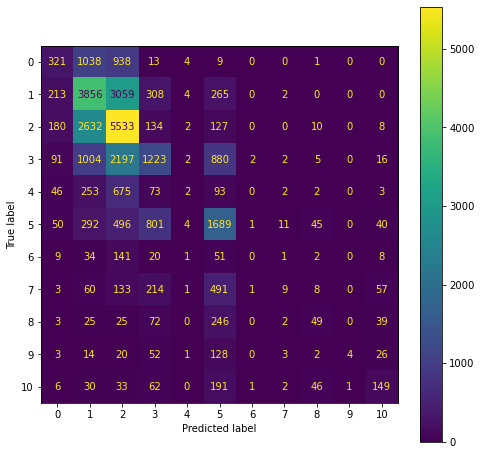

In [194]:
fig, axes = plt.subplots( figsize=(8, 8))
ConfusionMatrixDisplay.from_predictions(y_test, model5.predict(X_test), ax=axes)

In [195]:
model5_dims = len(model5.named_steps['transformer'].get_feature_names_out().tolist())

In [196]:
results.append(['Model5', 'Decision Tree 1', 'Moderate depth of 10',
                '{}'.format(model5_dims),
                '{}/{}/{}'.format(model5_acc_train, model5_acc_dev, model5_acc_test),
                model5_f1_test])

##### <ins>Conclusion on Model 5:</ins>
There's a small improvement in accuracy in model 5 as compared to the previous models. The training and test scores are on the same lines, still hinting that the model is under-fitted.

In the next model, I'll go all in on the maxdepth hyper-parameter. It might over-fit, but let's see if the test scores behave better

##### Model 6: Try a deeper Decision Tree Classifier (max-depth  =100). It might overfit, but let's see if the scores improve 

In [197]:
model6 = Pipeline([('transformer', ohe_transformer),
                     ('dt', DecisionTreeClassifier(max_depth=100, random_state=1234))])
model6.fit(X_train, y_train)

Pipeline(steps=[('transformer',
                 ColumnTransformer(remainder=StandardScaler(),
                                   transformers=[('onehotencoder',
                                                  OneHotEncoder(drop='if_binary'),
                                                  ['Hospital_code',
                                                   'Hospital_type_code',
                                                   'City_code_hospital',
                                                   'Hospital_region_code',
                                                   'Department', 'Ward_type',
                                                   'Ward_facility_code',
                                                   'Bed_grade',
                                                   'City_code_patient',
                                                   'Admission_type',
                                                   'Severity_illness',
                                                   'Age'])])),
                ('dt',
                 DecisionTreeClassifier(max_depth=100, random_state=1234))])

In [198]:
model6_acc_train,model6_acc_dev,model6_acc_test,model6_f1_test = \
        print_train_test_evaluation(model6, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model6 Decision tree")

Model6 Decision tree accuracy on train-data:	99.96
Model6 Decision tree accuracy on dev-data: 	30.07
Model6 Decision tree accuracy on test-data:	30.04
Model6 Decision tree F1 score on test-data:	30.04


In [199]:
model6_dims = len(model6.named_steps['transformer'].get_feature_names_out().tolist())

In [200]:
results.append(['Model6', 'Decision Tree 2', 'Deeper tree (max-depth=100)',
                '{}'.format(model6_dims),
                '{}/{}/{}'.format(model6_acc_train, model6_acc_dev, model6_acc_test),
                model6_f1_test])

##### <ins>Conclusion on Model 6:</ins>
It's interesting to see the training score has moved up dramatically almost to 100%. However, the dev and test scores have declined.

It is saying that, on the unseen data the model is poor. From the Exploratory Data Analysis, it didn't look like the data had too many outliers. Also, I've split the data using stratify=True, which means the target classes are split proportionately in train/dev/test splits. A little surprised to see such a big difference. May be, the explosion of number of dimensions (due to onehot encoding) is confusing the model. 

In the subsequent models (model8), I'll do feature selection and simplify the model

In the next model (model7), I'll do a hyper-parameter gridsearch on the decision trees to see if there's a balance on the train/dev/test scores

#### Model 7: Gridsearch Decision tree: 
Goal is to do a hyper-parameter gridsearch on the decision trees to see if there's a balance on the train/dev/test scores

In [201]:
model7_param_dict = {'dt__min_impurity_decrease': [0, 0.01, 0.02, 0.05],
             'dt__max_depth': [5, 10, 20, 50],
             'dt__min_samples_split': [0, 0.05, 0.1, 0.2]}

In [202]:
model7 = Pipeline([('transformer', ohe_transformer),
                     ('dt', DecisionTreeClassifier())])

In [203]:
%%time
model7_dt_grid = GridSearchCV(model7, model7_param_dict, scoring='accuracy', cv=3, verbose=2, n_jobs=-1)
model7_dt_grid.fit(X_train, y_train)

Fitting 3 folds for each of 64 candidates, totalling 192 fits
CPU times: user 10.8 s, sys: 1.43 s, total: 12.2 s
Wall time: 34 s


GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('transformer',
                                        ColumnTransformer(remainder=StandardScaler(),
                                                          transformers=[('onehotencoder',
                                                                         OneHotEncoder(drop='if_binary'),
                                                                         ['Hospital_code',
                                                                          'Hospital_type_code',
                                                                          'City_code_hospital',
                                                                          'Hospital_region_code',
                                                                          'Department',
                                                                          'Ward_type',
                                                                          'Ward_facility_code',
                                                                          'Bed_grade',
                                                                          'City_code_patient',
                                                                          'Admission_type',
                                                                          'Severity_illness',
                                                                          'Age'])])),
                                       ('dt', DecisionTreeClassifier())]),
             n_jobs=-1,
             param_grid={'dt__max_depth': [5, 10, 20, 50],
                         'dt__min_impurity_decrease': [0, 0.01, 0.02, 0.05],
                         'dt__min_samples_split': [0, 0.05, 0.1, 0.2]},
             scoring='accuracy', verbose=2)

In [204]:
model7_acc_train,model7_acc_dev,model7_acc_test,model7_f1_test = \
        print_train_test_evaluation(model7_dt_grid.best_estimator_, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model7 Gridsearch Decision tree")

Model7 Gridsearch Decision tree accuracy on train-data:	39.58
Model7 Gridsearch Decision tree accuracy on dev-data: 	40.04
Model7 Gridsearch Decision tree accuracy on test-data:	39.98
Model7 Gridsearch Decision tree F1 score on test-data:	39.98


In [205]:
print(model7_dt_grid.best_params_)

{'dt__max_depth': 10, 'dt__min_impurity_decrease': 0, 'dt__min_samples_split': 0.05}


In [206]:
model7_dims = len(model7_dt_grid.best_estimator_.named_steps['transformer'].get_feature_names_out().tolist())

In [207]:
results.append(['Model7', 'Gridsearch on Decision tree', '{}'.format(model7_dt_grid.best_params_),
                '{}'.format(model7_dims),
                '{}/{}/{}'.format(model7_acc_train, model7_acc_dev, model7_acc_test),
                model7_f1_test])

##### <ins>Conclusion on Model 7:</ins>
Seems like tweaking any of the min_impurity_decrease, max_depth, min_samples_split parameters doesn't have much effect on the overall efficacy of the model. The model just doesn't learn more than what earlier models were doing.

In next model, I'll reduce the dimensionality and see the effect

#### Model 8: Goal is to reduce the decision tree dimensionality using feature selection: 


In [208]:
model8_param_dict = {   'selector__estimator__alpha': [0.01, 0.04, 0.1, 0.5, 1]
                       
                    }

In [209]:
model8 = Pipeline(steps=[('transformer', ohe_transformer),
                                     ('selector', SelectFromModel(Lasso(fit_intercept=True))),
                                     ('dt', DecisionTreeClassifier(max_depth=10, random_state=1234))])


In [210]:
%%time
model8_dt_grid = GridSearchCV(model8, model8_param_dict, scoring='accuracy', cv=3, verbose=2, n_jobs=-1)
model8_dt_grid.fit(X_train, y_train)

Fitting 3 folds for each of 5 candidates, totalling 15 fits
CPU times: user 4.95 s, sys: 700 ms, total: 5.65 s
Wall time: 6.98 s


GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('transformer',
                                        ColumnTransformer(remainder=StandardScaler(),
                                                          transformers=[('onehotencoder',
                                                                         OneHotEncoder(drop='if_binary'),
                                                                         ['Hospital_code',
                                                                          'Hospital_type_code',
                                                                          'City_code_hospital',
                                                                          'Hospital_region_code',
                                                                          'Department',
                                                                          'Ward_type',
                                                                          'Ward_facility_code',
                                                                          'Bed_grade',
                                                                          'City_code_patient',
                                                                          'Admission_type',
                                                                          'Severity_illness',
                                                                          'Age'])])),
                                       ('selector',
                                        SelectFromModel(estimator=Lasso())),
                                       ('dt',
                                        DecisionTreeClassifier(max_depth=10,
                                                               random_state=1234))]),
             n_jobs=-1,
             param_grid={'selector__estimator__alpha': [0.01, 0.04, 0.1, 0.5,
                                                        1]},
             scoring='accuracy', verbose=2)

In [211]:
model8_dims = len(model8_dt_grid.best_estimator_.named_steps['selector'].get_feature_names_out().tolist())

In [212]:
model8_dt_grid.best_estimator_.named_steps['selector'].get_feature_names_out()

array(['x22', 'x25', 'x32', 'x40', 'x44', 'x45', 'x54', 'x55', 'x58',
       'x59', 'x61', 'x66', 'x67', 'x69', 'x71', 'x72', 'x81', 'x111',
       'x112', 'x114', 'x115', 'x118', 'x120', 'x122', 'x123', 'x124',
       'x125', 'x127', 'x128', 'x129'], dtype=object)

In [213]:
model8_acc_train,model8_acc_dev,model8_acc_test,model8_f1_test = \
        print_train_test_evaluation(model8_dt_grid.best_estimator_, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model8 Reduce dimensionality")

Model8 Reduce dimensionality accuracy on train-data:	41.7
Model8 Reduce dimensionality accuracy on dev-data: 	40.65
Model8 Reduce dimensionality accuracy on test-data:	40.42
Model8 Reduce dimensionality F1 score on test-data:	40.42


In [214]:
results.append(['Model8', 'Gridsearch on Feature extraction alpha', '{}'.format(model8_dt_grid.best_params_),
                '{}'.format(model8_dims),
                '{}/{}/{}'.format(model8_acc_train, model8_acc_dev, model8_acc_test),
                model8_f1_test])

##### <ins>Conclusion on Model 8:</ins>
Feature selection using Lasso with a nominal alpha knocked down 100 dimensions without losing any performance. We will definitely invite and accept these benefits and use them in subsequent models.

One gotcha: The categorical variables were onehot encoded. The feature selection should ideally keep all the onehot encoded derived columns of a categorical variable or remove all of them. This can be achieved by using GroupLasso from celer python package. However, I just chose to go with the feature selection by Lasso in sklearn.

The elephant in the room: The overall performance doesn't want to improve despite all these attempts.

I'll move onto RandomForests to leverage the "Wisdom of the Crowd" and see if the prediction performance improves

#### Model 9: Try Ensemble techniques to see if "Wisdom of the Crowd" helps improve prediction performance

So far, we have seen that the bias in the models is high (as the training accuracy itself is around 40%), except for one model with a deep decision tree(100 depth).

I'll first build an Boosting Ensemble technique, that is built on the paradigm of multiple shallow trees (Decision Stumps) put together will build a strong model

In [215]:
%%time
model9_param_grid = {'boost__n_estimators': [10, 25, 50, 100, 200]
                    }

model9 = Pipeline(steps=[('transformer', ohe_transformer),
                         ('selector', SelectFromModel(Lasso(alpha=0.01, fit_intercept=True))),
                         ('boost', \
                            AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=1),
                                               random_state=42))])

model9_grid = GridSearchCV(model9, param_grid=model9_param_grid, verbose=0, n_jobs=-1).fit(X_train, y_train)


Fitting 5 folds for each of 5 candidates, totalling 25 fits
CPU times: user 6.31 s, sys: 894 ms, total: 7.2 s
Wall time: 40.7 s


In [216]:
model9_acc_train,model9_acc_dev,model9_acc_test,model9_f1_test = \
        print_train_test_evaluation(model9_grid.best_estimator_, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model9 Ensemble with Adaboost")

Model9 Ensemble with Adaboost accuracy on train-data:	36.96
Model9 Ensemble with Adaboost accuracy on dev-data: 	37.32
Model9 Ensemble with Adaboost accuracy on test-data:	37.38
Model9 Ensemble with Adaboost F1 score on test-data:	37.38


In [217]:
model9_dims = len(model9_grid.best_estimator_.named_steps['selector'].get_feature_names_out().tolist())

In [218]:
results.append(['Model9', 'Adaboost to compensate for high bias', '{}'.format(model9_grid.best_params_),
                '{}'.format(model9_dims),
                '{}/{}/{}'.format(model9_acc_train, model9_acc_dev, model9_acc_test),
                model9_f1_test])

##### <ins>Conclusion on Model 9:</ins>
I'm a little surprised that the boosting didnot help much. It is normally said that when nothing works, Boosting does. Apparently, the observed results are not inline with that.

One reason for this could be the inherent requirement of Ensemble techiniques, which is: the crowd should have independent opinions. 
In this dataset, there are many Case_ids per Patient_id; this might be intuitively violating the above inherent requirement, as there are multiple records for a single patient.

I'll next try Gradient Boosting 

#### Model 10: Try the Gradient Boosting. The goal is on similar lines of Model9, but with a different boosting technique


In [219]:
%%time
model10_param_grid = {'gboost__n_estimators': [10, 50, 100, 200]
                     }

model10 = Pipeline(steps=[('transformer', ohe_transformer),
                         ('selector', SelectFromModel(Lasso(alpha=0.01, fit_intercept=True))),
                         ('gboost', \
                            GradientBoostingClassifier(random_state=42))])

model10_grid = GridSearchCV(model10, param_grid=model10_param_grid, cv=3, verbose=0, n_jobs=-1).fit(X_train, y_train);


Fitting 3 folds for each of 4 candidates, totalling 12 fits
[CV] END dt__max_depth=5, dt__min_impurity_decrease=0, dt__min_samples_split=0; total time=   1.1s
[CV] END dt__max_depth=5, dt__min_impurity_decrease=0, dt__min_samples_split=0.2; total time=   1.0s
[CV] END dt__max_depth=5, dt__min_impurity_decrease=0.02, dt__min_samples_split=0; total time=   0.6s
[CV] END dt__max_depth=5, dt__min_impurity_decrease=0.02, dt__min_samples_split=0.05; total time=   0.8s
[CV] END dt__max_depth=5, dt__min_impurity_decrease=0.05, dt__min_samples_split=0; total time=   0.5s
[CV] END dt__max_depth=10, dt__min_impurity_decrease=0, dt__min_samples_split=0; total time=   0.7s
[CV] END dt__max_depth=10, dt__min_impurity_decrease=0, dt__min_samples_split=0.05; total time=   1.4s
[CV] END dt__max_depth=10, dt__min_impurity_decrease=0.01, dt__min_samples_split=0.2; total time=   1.0s
[CV] END dt__max_depth=10, dt__min_impurity_decrease=0.05, dt__min_samples_split=0; total time=   0.6s
[CV] END dt__max_dep

[CV] END dt__max_depth=5, dt__min_impurity_decrease=0, dt__min_samples_split=0.1; total time=   1.6s
[CV] END dt__max_depth=5, dt__min_impurity_decrease=0.01, dt__min_samples_split=0.1; total time=   1.3s
[CV] END dt__max_depth=5, dt__min_impurity_decrease=0.05, dt__min_samples_split=0; total time=   0.6s
[CV] END dt__max_depth=5, dt__min_impurity_decrease=0.05, dt__min_samples_split=0.1; total time=   1.0s
[CV] END dt__max_depth=10, dt__min_impurity_decrease=0, dt__min_samples_split=0.2; total time=   1.1s
[CV] END dt__max_depth=10, dt__min_impurity_decrease=0.01, dt__min_samples_split=0.2; total time=   1.0s
[CV] END dt__max_depth=10, dt__min_impurity_decrease=0.02, dt__min_samples_split=0.1; total time=   1.0s
[CV] END dt__max_depth=10, dt__min_impurity_decrease=0.05, dt__min_samples_split=0.1; total time=   0.9s
[CV] END dt__max_depth=20, dt__min_impurity_decrease=0, dt__min_samples_split=0.1; total time=   1.3s
[CV] END dt__max_depth=20, dt__min_impurity_decrease=0.01, dt__min_sam

[CV] END dt__max_depth=5, dt__min_impurity_decrease=0, dt__min_samples_split=0.05; total time=   1.7s
[CV] END dt__max_depth=5, dt__min_impurity_decrease=0.01, dt__min_samples_split=0.05; total time=   1.1s
[CV] END dt__max_depth=5, dt__min_impurity_decrease=0.02, dt__min_samples_split=0; total time=   0.5s
[CV] END dt__max_depth=5, dt__min_impurity_decrease=0.02, dt__min_samples_split=0.2; total time=   1.0s
[CV] END dt__max_depth=5, dt__min_impurity_decrease=0.05, dt__min_samples_split=0.1; total time=   0.9s
[CV] END dt__max_depth=10, dt__min_impurity_decrease=0, dt__min_samples_split=0.1; total time=   1.2s
[CV] END dt__max_depth=10, dt__min_impurity_decrease=0.01, dt__min_samples_split=0.05; total time=   0.9s
[CV] END dt__max_depth=10, dt__min_impurity_decrease=0.02, dt__min_samples_split=0; total time=   0.5s
[CV] END dt__max_depth=10, dt__min_impurity_decrease=0.02, dt__min_samples_split=0.2; total time=   0.9s
[CV] END dt__max_depth=10, dt__min_impurity_decrease=0.05, dt__min_

In [220]:
model10_acc_train,model10_acc_dev,model10_acc_test,model10_f1_test = \
        print_train_test_evaluation(model10_grid.best_estimator_, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model10 Ensemble with Gradient Descent")

Model10 Ensemble with Gradient Descent accuracy on train-data:	41.58
Model10 Ensemble with Gradient Descent accuracy on dev-data: 	41.3
Model10 Ensemble with Gradient Descent accuracy on test-data:	41.19
Model10 Ensemble with Gradient Descent F1 score on test-data:	41.19


In [221]:
model10_dims = len(model10_grid.best_estimator_.named_steps['selector'].get_feature_names_out().tolist())

In [222]:
results.append(['Model10', 'Gradientboost to compensate for high bias', '{}'.format(model10_grid.best_params_),
                '{}'.format(model10_dims),
                '{}/{}/{}'.format(model10_acc_train, model10_acc_dev, model10_acc_test),
                model10_f1_test])

##### <ins>Conclusion on Model 10:</ins>
Little bit of improvement compared to Adaboost and that's about it!!

#### Model 11: RandomForest ensemble model
The goal is to try to leverage the 99.6% accuracy seen on training data in Model6 with the very deep decision tree model coupled with a bagging technique. Bagging is built on the construct of a base classifier having high variance, which is true in Model6 case (as training score is very high, but dev/test scores aren't)


In [223]:
n_trees = [1, 10, 50]

In [224]:
oob_scores = []
forests = []
for i in range(len(n_trees)):
    cur_forest = Pipeline(steps=[('transformer', ohe_transformer),
                         ('selector', SelectFromModel(Lasso(alpha=0.01, fit_intercept=True))),
                         ('rf', \
                            RandomForestClassifier(n_estimators=n_trees[i], max_depth=100, random_state=42, oob_score=True))])
    cur_forest.fit(X_train, y_train)
    forests.append(cur_forest)
    oob_scores.append(cur_forest.named_steps['rf'].oob_score_)

print(oob_scores)

[0.153042871824989, 0.30914605050653354, 0.33507377771252383]


In [225]:
for i in range(len(n_trees)):
    model11_acc_train = round(accuracy_score(y_train, forests[i].predict(X_train))*100, 2)
    model11_acc_dev   = round(accuracy_score(y_dev, forests[i].predict(X_dev))*100, 2)
    model11_acc_test  = round(accuracy_score(y_test, forests[i].predict(X_test))*100, 2)
    model11_f1_test = round(f1_score(y_test, forests[i].predict(X_test), average='micro')*100, 2)

    print(f'Model11 accuracy with {n_trees[i]} estimators on train-data:\t{model11_acc_train}')
    print(f'Model11 accuracy with {n_trees[i]} estimators on dev-data:\t{model11_acc_dev}')
    print(f'Model11 accuracy with {n_trees[i]} estimators accuracy on test-data:\t{model11_acc_test}')
    print(f'Model11 accuracy with {n_trees[i]} estimators F1 score on test-data:\t{model11_f1_test}')
    print('\n')

Model11 accuracy with 1 estimators on train-data:	73.72
Model11 accuracy with 1 estimators on dev-data:	28.93
Model11 accuracy with 1 estimators accuracy on test-data:	28.51
Model11 accuracy with 1 estimators F1 score on test-data:	28.51


Model11 accuracy with 10 estimators on train-data:	96.69
Model11 accuracy with 10 estimators on dev-data:	33.27
Model11 accuracy with 10 estimators accuracy on test-data:	33.02
Model11 accuracy with 10 estimators F1 score on test-data:	33.02


Model11 accuracy with 50 estimators on train-data:	99.81
Model11 accuracy with 50 estimators on dev-data:	33.98
Model11 accuracy with 50 estimators accuracy on test-data:	33.79
Model11 accuracy with 50 estimators F1 score on test-data:	33.79




In [226]:
results.append(['Model11', 'RandomForests with deep trees to compensate for high variance',
                'max_depth: {}'.format(forests[2].named_steps['rf'].get_params()['max_depth']),
                '{}'.format(30),
                '{}/{}/{}'.format(model11_acc_train, model11_acc_dev, model11_acc_test),
                model11_f1_test])

##### <ins>Conclusion on Model 11:</ins>
How many be the number of deep trees in the randomforest, the models are doing well on training data (high variance) but falling flat on unseen (dev/test) data.

In [227]:
results_df = pd.DataFrame(data=results, 
                          columns=['Model-name', 'Description', 'Purpose', '# Dimensions', 'Train/Dev/Test Accuracies', 'F1 Score'])

In [228]:
results_df

,Model-name,Description,Purpose,# Dimensions,Train/Dev/Test Accuracies,F1 Score
0,Model0,Random guessing,For a baseline,---,9.09,---
1,Model1,Logistic Regr,Initial logistic regr model,---,38.91/38.85/38.65,38.65
2,Model2,Basic Logistic Regr with OneHot on all categ,Baseline,130,38.97/38.89/38.87,38.87
3,Model3,GridSearch Logistic Regr hyper params,"{'lgr__C': 0.18957356524063793, 'lgr__max_iter...",130,40.13/40.14/40.13,40.13
4,Model4,GridSearch kNN hyper params,{'knn__n_neighbors': 50},130,41.89/39.04/39.24,39.24
5,Model5,Decision Tree 1,Moderate depth of 10,130,42.14/41.22/41.22,41.22
6,Model6,Decision Tree 2,Deeper tree (max-depth=100),130,99.96/30.07/30.04,30.04
7,Model7,Gridsearch on Decision tree,"{'dt__max_depth': 10, 'dt__min_impurity_decrea...",130,39.58/40.04/39.98,39.98
8,Model8,Gridsearch on Feature extraction alpha,{'selector__estimator__alpha': 0.01},30,41.7/40.65/40.42,40.42
9,Model9,Adaboost to compensate for high bias,{'boost__n_estimators': 25},30,36.96/37.32/37.38,37.38
